In [1]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("karakaggle/kaggle-cat-vs-dog-dataset")

print("Path to dataset files:", path)

c:\Users\rrpra\AppData\Local\Programs\Python\Python313\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Path to dataset files: C:\Users\rrpra\.cache\kagglehub\datasets\karakaggle\kaggle-cat-vs-dog-dataset\versions\1


In [2]:
import os
from PIL import Image
import numpy as np

# Empty list to hold image data
cat_images = []
cat_folder_path = os.path.join(path,'kagglecatsanddogs_3367a\PetImages\Cat')
dog_images = []
dog_folder_path = os.path.join(path,'kagglecatsanddogs_3367a\PetImages\Dog')
folders =((cat_images,cat_folder_path),(dog_images,dog_folder_path))
# Loop through all files in the folder

for arr,folder_path in folders:
    x=0 
    print(f"\ntotal img loaded from {folder_path}:- ")
    for filename in os.listdir(folder_path):
        print('\r'+str(x),end='')
        x+=1
        if x>1000:
            break
        if filename.lower().endswith(".jpg"):
            img_path = os.path.join(folder_path, filename)

            # Open the image
            img = np.array(Image.open(img_path).convert("RGB").resize((224, 224)))  # convert to RGB (if grayscale or RGBA)

            # Add the image object to the list
            arr.append(img)

    # Check how many images loaded
    print(f"\nLoaded {len(cat_images)} images.")
cat_images = np.array(cat_images)
dog_images = np.array(dog_images)


<>:7: SyntaxWarning: invalid escape sequence '\P'
<>:9: SyntaxWarning: invalid escape sequence '\P'
<>:7: SyntaxWarning: invalid escape sequence '\P'
<>:9: SyntaxWarning: invalid escape sequence '\P'
C:\Users\rrpra\AppData\Local\Temp\ipykernel_11332\2571756176.py:7: SyntaxWarning: invalid escape sequence '\P'
  cat_folder_path = os.path.join(path,'kagglecatsanddogs_3367a\PetImages\Cat')
C:\Users\rrpra\AppData\Local\Temp\ipykernel_11332\2571756176.py:9: SyntaxWarning: invalid escape sequence '\P'
  dog_folder_path = os.path.join(path,'kagglecatsanddogs_3367a\PetImages\Dog')



total img loaded from C:\Users\rrpra\.cache\kagglehub\datasets\karakaggle\kaggle-cat-vs-dog-dataset\versions\1\kagglecatsanddogs_3367a\PetImages\Cat:- 
1000
Loaded 1000 images.

total img loaded from C:\Users\rrpra\.cache\kagglehub\datasets\karakaggle\kaggle-cat-vs-dog-dataset\versions\1\kagglecatsanddogs_3367a\PetImages\Dog:- 
1000
Loaded 1000 images.


(1000, 224, 224, 3)
(1000, 224, 224, 3)


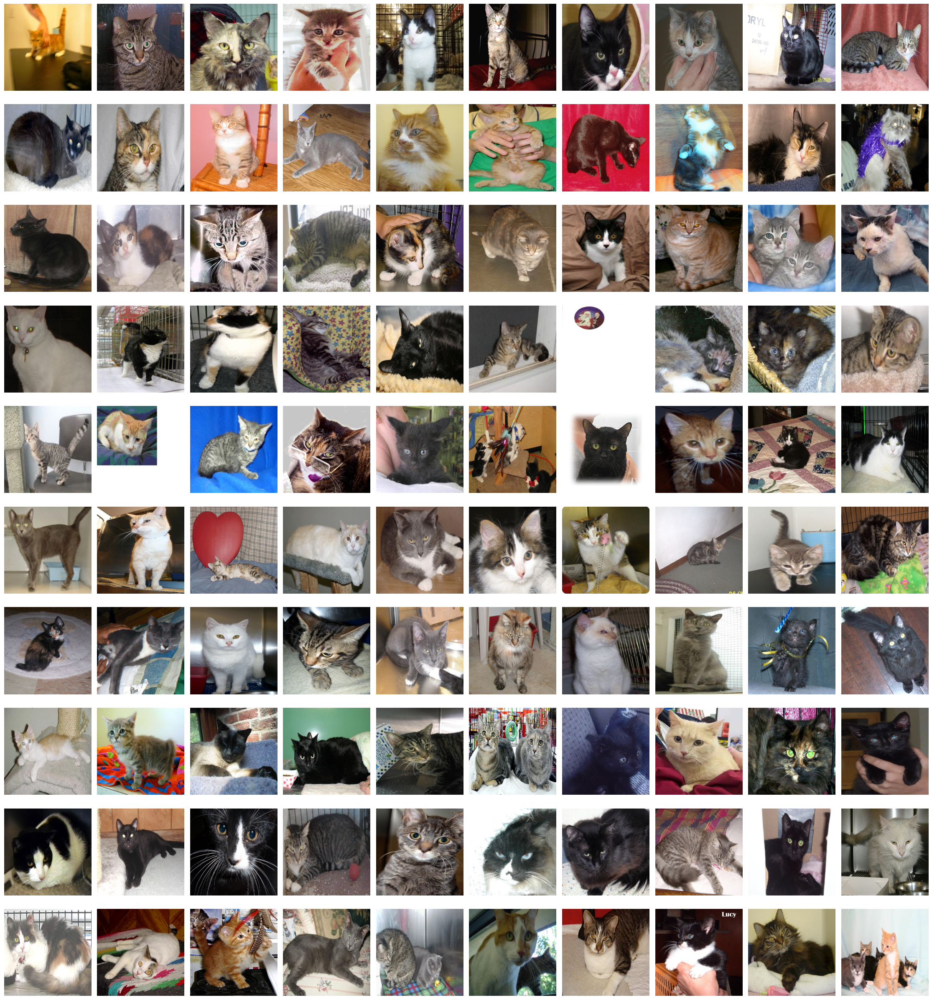

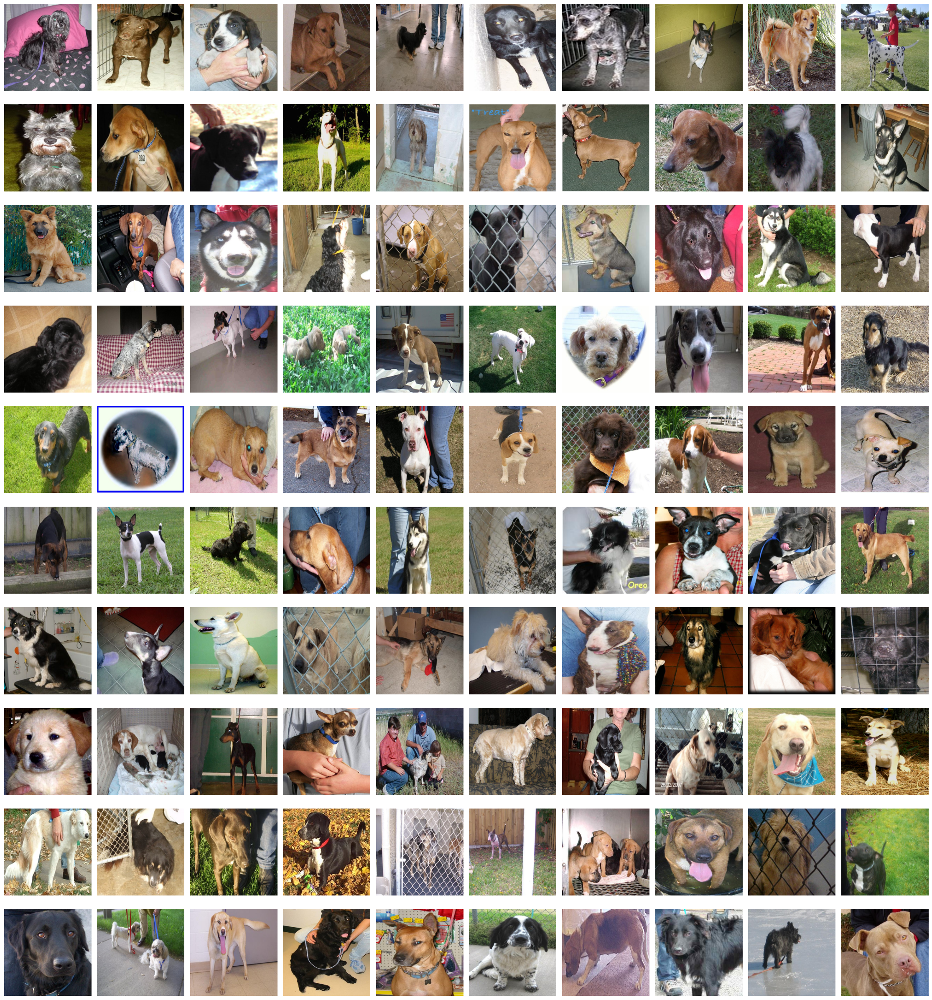

In [3]:
import matplotlib.pyplot as plt
dpi=96
print(cat_images.shape)
print(dog_images.shape)
n_rows, n_cols = 10, 10
img_size = cat_images.shape[1]
imsize_inch = img_size / dpi
fig_width = n_cols * (imsize_inch + 0.2*1)
fig_height = n_rows * (imsize_inch + 0.4*0)
for images in [cat_images,dog_images]:
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(fig_height, fig_width) ,dpi=dpi)
    for i,ax in enumerate(axes.flatten()):
        ax.imshow(images[i])
        ax.axis('off')
    plt.tight_layout()
    plt.show()



In [4]:
import random
tagged = [(x, 0) for x in dog_images] + [(x, 1) for x in cat_images]
random.shuffle(tagged)
all_images, labels = map(np.array,zip(*tagged))
print(all_images.shape)
print(labels.shape)
del dog_images
del cat_images

(2000, 224, 224, 3)
(2000,)


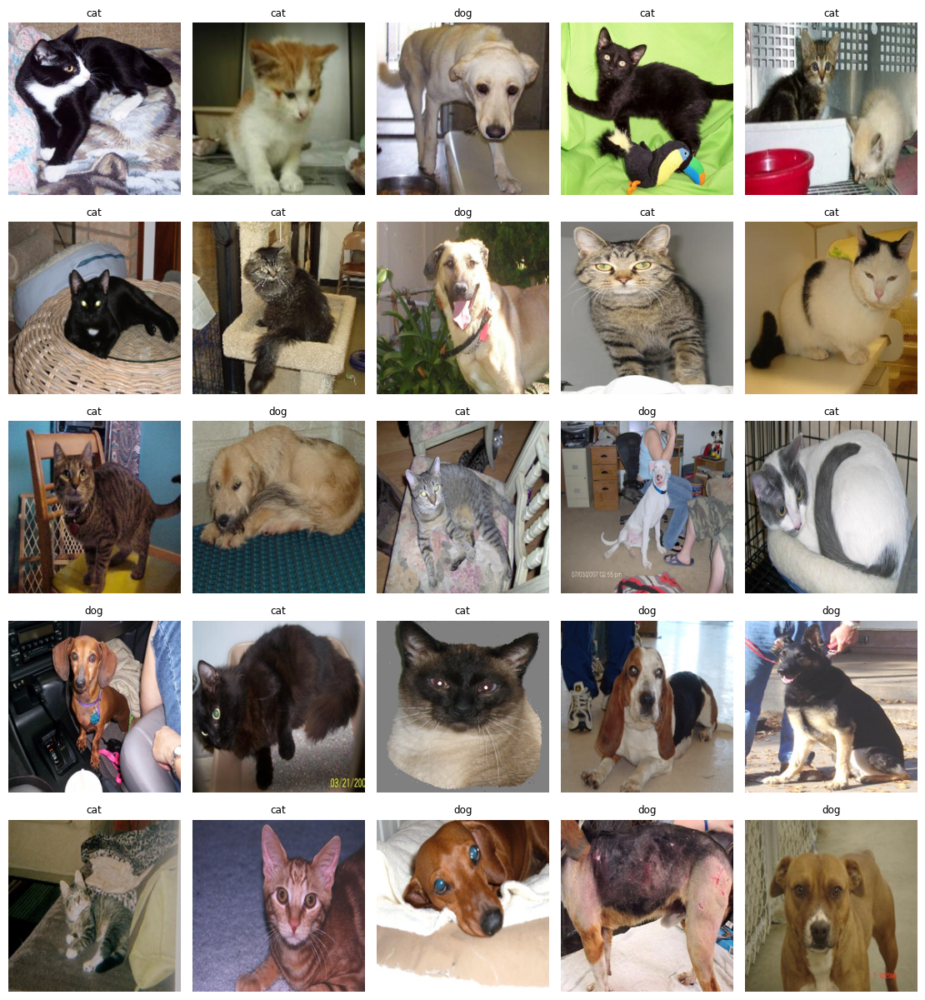

In [5]:
n_rows,n_cols = 5,5

img_size = all_images.shape[1]
imsize_inch = img_size / dpi
fig_width = n_cols * (imsize_inch + 0.2*1)
fig_height = n_rows * (imsize_inch + 0.4*0)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(fig_height, fig_width) ,dpi=dpi)
for i,ax in enumerate(axes.flatten()):
    ax.imshow(all_images[i])
    ax.set_title('cat' if labels[i] else 'dog',fontsize=9)
    ax.axis('off')
plt.tight_layout()
plt.show()

In [6]:
import numpy as np

class BasicNeuron:
    def __init__(self, num_inputs, activation_function):
        self.weights = np.random.rand(num_inputs)
        self.bias = np.random.rand(1)
        self.activation_function = activation_function

    def forward(self, inputs):
        inputs = np.asarray(inputs).reshape(-1)
        weighted_sum = np.dot(inputs, self.weights) + self.bias
        output = self.activation_function(weighted_sum)
        return output

def sigmoid(x):
    return 1 / (1 + np.exp(-x))

# Create a neuron with 3 inputs and sigmoid activation
neuron = BasicNeuron(3, sigmoid)

# Example inputs
inputs = np.array((0.6, 0.2, 0.9))

# Get neuron output
output = neuron.forward(inputs)
print("Neuron Output:", output)


Neuron Output: [0.64456506]


In [7]:
def step_function(x):
  return int(x[0]) if x >= 0 else 0
class Perceptron:
  def __init__(self, num_inputs, learning_rate=0.01):
    self.neuron = BasicNeuron(num_inputs, step_function)
    self.learning_rate = learning_rate

  def predict(self, inputs):
    return self.neuron.forward(inputs)

  def train(self, training_inputs, labels, epochs):
    for epoch in range(epochs):
        l=[]
        for inputs, label in zip(training_inputs, labels):
            prediction = self.predict(inputs)
            error = label - prediction
            l.append(error)
            # Perceptron learning rule update
            self.neuron.weights += self.learning_rate * error * inputs
            self.neuron.bias += self.learning_rate * error
        #print('error',sum(l)/len(l))

In [8]:
all_images_reshaped = all_images.reshape(-1, 224*224*3)
all_images_normalized = all_images_reshaped / 255.0
print(all_images_normalized.shape)
del all_images_reshaped

(2000, 150528)


In [14]:
for i in range(1,10):
  per = .1*i
  num_selected = int(per * all_images_normalized.shape[0])
  arr = np.random.choice(all_images_normalized.shape[0], num_selected, replace=False)
  x_train,y_train = all_images_normalized[arr], labels[arr]
  x_test,y_test = all_images_normalized[~arr], labels[~arr]
  print(f"train percentage {round(per*100,0)}% data shape are:-x_train:-{x_train.shape},y_train:-{y_train.shape},x_test:-{x_test.shape},y_test:-{y_test.shape}")
  model = Perceptron(x_train.shape[1])
  model.train(x_train,y_train,20)
  # Generate predictions for the test data
  predictions = np.array([model.predict(inputs) for inputs in x_test])

  y_true = y_test

  for cls in [0, 1]:

    # mask of samples whose true label is 'cls'
    mask = (y_true == cls)

    # number of samples in that class
    n_cls = np.sum(mask)

    # number of correct predictions among them
    correct_cls = np.sum(predictions[mask] == cls)
    wrong_cls = np.sum(predictions[~mask] == cls)

    # accuracy for this class
    acc_cls = correct_cls / n_cls

    print(f"Accuracy for class {'cat' if labels[i] else 'dog'}: {acc_cls:.4f}   ({correct_cls} / {n_cls}), wrong prediction {wrong_cls}, total data {len(y_true)}")

train percentage 60.0% data shape are:-x_train:-(1200, 150528),y_train:-(1200,),x_test:-(1200, 150528),y_test:-(1200,)
Accuracy for class cat: 1.0000   (585 / 585), wrong prediction 615, total data 1200
Accuracy for class cat: 0.0000   (0 / 615), wrong prediction 0, total data 1200
train percentage 70.0% data shape are:-x_train:-(1400, 150528),y_train:-(1400,),x_test:-(1400, 150528),y_test:-(1400,)
Accuracy for class dog: 1.0000   (711 / 711), wrong prediction 689, total data 1400
Accuracy for class dog: 0.0000   (0 / 689), wrong prediction 0, total data 1400
train percentage 80.0% data shape are:-x_train:-(1600, 150528),y_train:-(1600,),x_test:-(1600, 150528),y_test:-(1600,)
Accuracy for class cat: 1.0000   (810 / 810), wrong prediction 790, total data 1600
Accuracy for class cat: 0.0000   (0 / 790), wrong prediction 0, total data 1600
train percentage 90.0% data shape are:-x_train:-(1800, 150528),y_train:-(1800,),x_test:-(1800, 150528),y_test:-(1800,)
Accuracy for class cat: 1.0000  